In [17]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
import wandb
import os
import matplotlib.animation as animation
from IPython.display import HTML
from torch.utils.data import DataLoader, TensorDataset

# Set random seeds for reproducibility
np.random.seed(42)
torch.manual_seed(42)

# Task 3 - Deep versus wide networks

## Data Generation for Noisy-XOR Problem

We'll generate data points according to the formula:
$(x_1, x_2, y) = (m_1 + s\eta_1, m_2 + s\eta_2, m_1 \text{ xor } m_2)$

where $(m_1, m_2) \in \{(0,0), (0,1), (1,0), (1,1)\}$ are cluster centers, $s$ is the standard deviation, and $\eta_1, \eta_2$ are normally distributed random variables.

In [18]:
class NoisyXORGenerator:
    def __init__(self, s=0.1, seed=None):
        # s: standard deviation for noise
        # seed: random seed for reproducibility
        self.s = s
        self.seed = seed
        
        # Four cluster centers for XOR problem
        self.cluster_centers = np.array([
            [0, 0],  # XOR output: 0
            [0, 1],  # XOR output: 1
            [1, 0],  # XOR output: 1
            [1, 1]   # XOR output: 0
        ])
        
        # XOR labels for each cluster
        self.cluster_labels = np.array([0, 1, 1, 0])
    
    def generate(self, n_samples):
        # Generate noisy XOR data with n_samples points
        if self.seed is not None:
            np.random.seed(self.seed)
        
        # Distribute samples evenly across clusters
        samples_per_cluster = n_samples // 4
        remainder = n_samples % 4
        
        X = []
        y = []
        
        for i in range(4):
            n = samples_per_cluster + (1 if i < remainder else 0)
            
            # Add Normal(0,1) noise scaled by s
            eta = np.random.randn(n, 2)
            cluster_samples = self.cluster_centers[i] + self.s * eta
            
            X.append(cluster_samples)
            y.append(np.full(n, self.cluster_labels[i]))
        
        X = np.vstack(X)
        y = np.concatenate(y)
        
        # Shuffle the data
        indices = np.random.permutation(n_samples)
        X = X[indices]
        y = y[indices]
        
        return X, y
    
    def generate_train_test(self, n_train=2000, n_test=500):
        # Generate separate training and test sets
        X_train, y_train = self.generate(n_train)
        
        # Use different seed for test data
        old_seed = self.seed
        if self.seed is not None:
            self.seed += 1
        
        X_test, y_test = self.generate(n_test)
        
        # Restore original seed
        self.seed = old_seed
        
        return X_train, X_test, y_train, y_test

# Create generator and generate sample dataset
generator = NoisyXORGenerator(s=0.1, seed=42)
X, y = generator.generate(1000)

print(f"Generated {len(X)} samples")
print(f"Feature shape: {X.shape}")
print(f"Label shape: {y.shape}")
print(f"Class distribution: {np.bincount(y.astype(int))}")

Generated 1000 samples
Feature shape: (1000, 2)
Label shape: (1000,)
Class distribution: [500 500]


### Visualization of the Generated Data

Let's visualize the noisy-XOR dataset with different noise levels to understand the problem better.

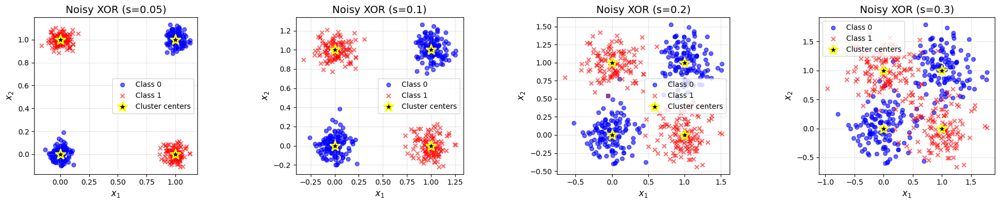

In [19]:
def visualize_noisy_xor(n_samples=500, noise_levels=[0.05, 0.1, 0.2, 0.3]):
    # Visualize noisy XOR data with different noise levels
    fig, axes = plt.subplots(1, len(noise_levels), figsize=(5*len(noise_levels), 4))
    
    if len(noise_levels) == 1:
        axes = [axes]
    
    for ax, s in zip(axes, noise_levels):
        gen = NoisyXORGenerator(s=s, seed=42)
        X, y = gen.generate(n_samples)
        
        # Plot class 0 and 1
        mask_0 = y == 0
        mask_1 = y == 1
        ax.scatter(X[mask_0, 0], X[mask_0, 1], 
                  c='blue', marker='o', s=30, alpha=0.6, label='Class 0')
        ax.scatter(X[mask_1, 0], X[mask_1, 1], 
                  c='red', marker='x', s=30, alpha=0.6, label='Class 1')
        
        # Mark cluster centers
        centers = np.array([[0, 0], [0, 1], [1, 0], [1, 1]])
        ax.scatter(centers[:, 0], centers[:, 1], 
                  c='black', marker='*', s=200, 
                  edgecolors='yellow', linewidths=2, 
                  label='Cluster centers', zorder=5)
        
        ax.set_xlabel('$x_1$', fontsize=12)
        ax.set_ylabel('$x_2$', fontsize=12)
        ax.set_title(f'Noisy XOR (s={s})', fontsize=14)
        ax.legend()
        ax.grid(True, alpha=0.3)
        ax.set_aspect('equal')
        
    plt.tight_layout()
    plt.show()

# Visualize with different noise levels
visualize_noisy_xor(n_samples=500, noise_levels=[0.05, 0.1, 0.2, 0.3])

### Train/Test Split

Let's create training and test datasets for model evaluation.

In [20]:
# Create datasets using the generator
generator = NoisyXORGenerator(s=0.1, seed=42)
X_train, X_test, y_train, y_test = generator.generate_train_test(n_train=2000, n_test=500)

print("Training set:")
print(f"  X_train shape: {X_train.shape}")
print(f"  y_train shape: {y_train.shape}")
print(f"  Class distribution: {np.bincount(y_train.astype(int))}")
print()
print("Test set:")
print(f"  X_test shape: {X_test.shape}")
print(f"  y_test shape: {y_test.shape}")
print(f"  Class distribution: {np.bincount(y_test.astype(int))}")

Training set:
  X_train shape: (2000, 2)
  y_train shape: (2000,)
  Class distribution: [1000 1000]

Test set:
  X_test shape: (500, 2)
  y_test shape: (500,)
  Class distribution: [250 250]


### Decision Boundary Visualization Helper

This function will be useful later to visualize the decision boundaries learned by neural networks.

In [21]:
def plot_decision_boundary(model, X, y, title="Decision Boundary", resolution=0.01):
    # Plot decision boundary for a binary classifier
    # model: trained model with predict method
    # X: input features, y: true labels
    
    # Create mesh grid for decision boundary
    x_min, x_max = X[:, 0].min() - 0.3, X[:, 0].max() + 0.3
    y_min, y_max = X[:, 1].min() - 0.3, X[:, 1].max() + 0.3
    xx, yy = np.meshgrid(np.arange(x_min, x_max, resolution),
                         np.arange(y_min, y_max, resolution))
    
    # Predict on the mesh
    Z = model.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    
    # Plot decision boundary
    plt.figure(figsize=(8, 6))
    plt.contourf(xx, yy, Z, alpha=0.3, levels=1, cmap='RdBu')
    plt.contour(xx, yy, Z, levels=[0.5], colors='black', linewidths=2)
    
    # Plot data points
    mask_0 = y == 0
    mask_1 = y == 1
    plt.scatter(X[mask_0, 0], X[mask_0, 1], 
               c='blue', marker='o', s=30, alpha=0.6, label='Class 0', edgecolors='k')
    plt.scatter(X[mask_1, 0], X[mask_1, 1], 
               c='red', marker='x', s=30, alpha=0.6, label='Class 1')
    
    # Mark cluster centers
    centers = np.array([[0, 0], [0, 1], [1, 0], [1, 1]])
    plt.scatter(centers[:, 0], centers[:, 1], 
               c='black', marker='*', s=200, 
               edgecolors='yellow', linewidths=2, 
               label='Cluster centers', zorder=5)
    
    plt.xlabel('$x_1$', fontsize=12)
    plt.ylabel('$x_2$', fontsize=12)
    plt.title(title, fontsize=14)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

print("Decision boundary visualization function defined.")

Decision boundary visualization function defined.


In [22]:
class DynamicXORModel(nn.Module):
    def __init__(self, input_dim=2, hidden_layers=1, hidden_dim=10, output_dim=1):
        super(DynamicXORModel, self).__init__()
        layers = []
        current_dim = input_dim
        # Create hidden layers
        for _ in range(hidden_layers):
            layers.append(nn.Linear(in_features=current_dim, out_features=hidden_dim))
            layers.append(nn.Tanh())
            current_dim = hidden_dim
        # Output layer
        layers.append(nn.Linear(in_features=current_dim, out_features=output_dim))
        layers.append(nn.Sigmoid())
        self.network = nn.Sequential(*layers)
        
    def forward(self, x):
        return self.network(x)
    
    def predict(self, X):
        self.eval()
        with torch.no_grad():
            if isinstance(X, np.ndarray):
                X_tensor = torch.FloatTensor(X)
            else:
                X_tensor = X
            predictions = self.forward(X_tensor)
            return predictions.numpy()

In [23]:
# Prepare data for PyTorch
# Convert numpy arrays to tensors
X_train_tensor = torch.FloatTensor(X_train)
y_train_tensor = torch.FloatTensor(y_train).unsqueeze(1) # Add dimension for BCELoss
X_test_tensor = torch.FloatTensor(X_test)
y_test_tensor = torch.FloatTensor(y_test).unsqueeze(1)

# Create TensorDatasets
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

# Create DataLoaders
batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

print(f"Data prepared: {len(train_dataset)} training samples, {len(test_dataset)} test samples.")

Data prepared: 2000 training samples, 500 test samples.


In [24]:
def train_loop(model, train_loader, val_loader, criterion, optimizer, epochs, verbose=True):
    train_losses = []
    val_losses = []
    
    for epoch in range(epochs):
        # Training phase
        model.train()
        running_loss = 0.0
        for inputs, targets in train_loader:
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            loss.backward()
            optimizer.step()
            running_loss += loss.item() * inputs.size(0)
        
        epoch_train_loss = running_loss / len(train_loader.dataset)
        train_losses.append(epoch_train_loss)
        
        # Validation phase
        model.eval()
        running_val_loss = 0.0
        with torch.no_grad():
            for inputs, targets in val_loader:
                outputs = model(inputs)
                loss = criterion(outputs, targets)
                running_val_loss += loss.item() * inputs.size(0)
        
        epoch_val_loss = running_val_loss / len(val_loader.dataset)
        val_losses.append(epoch_val_loss)
        
        if verbose:
            print(f"Epoch {epoch+1}/{epochs} | Train Loss: {epoch_train_loss:.5f} | Val Loss: {epoch_val_loss:.5f}")
            
    return train_losses, val_losses

Epoch 1/35 | Train Loss: 0.68731 | Val Loss: 0.65719
Epoch 2/35 | Train Loss: 0.61584 | Val Loss: 0.54915
Epoch 2/35 | Train Loss: 0.61584 | Val Loss: 0.54915
Epoch 3/35 | Train Loss: 0.45983 | Val Loss: 0.34640
Epoch 4/35 | Train Loss: 0.25347 | Val Loss: 0.16021
Epoch 5/35 | Train Loss: 0.11460 | Val Loss: 0.07318
Epoch 6/35 | Train Loss: 0.05656 | Val Loss: 0.04026
Epoch 7/35 | Train Loss: 0.03338 | Val Loss: 0.02556
Epoch 8/35 | Train Loss: 0.02238 | Val Loss: 0.01795
Epoch 9/35 | Train Loss: 0.01623 | Val Loss: 0.01341
Epoch 10/35 | Train Loss: 0.01239 | Val Loss: 0.01042
Epoch 3/35 | Train Loss: 0.45983 | Val Loss: 0.34640
Epoch 4/35 | Train Loss: 0.25347 | Val Loss: 0.16021
Epoch 5/35 | Train Loss: 0.11460 | Val Loss: 0.07318
Epoch 6/35 | Train Loss: 0.05656 | Val Loss: 0.04026
Epoch 7/35 | Train Loss: 0.03338 | Val Loss: 0.02556
Epoch 8/35 | Train Loss: 0.02238 | Val Loss: 0.01795
Epoch 9/35 | Train Loss: 0.01623 | Val Loss: 0.01341
Epoch 10/35 | Train Loss: 0.01239 | Val Loss:

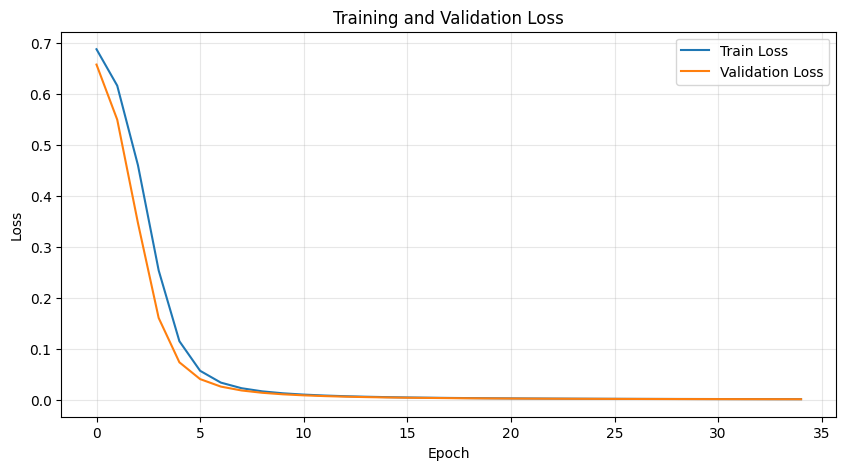

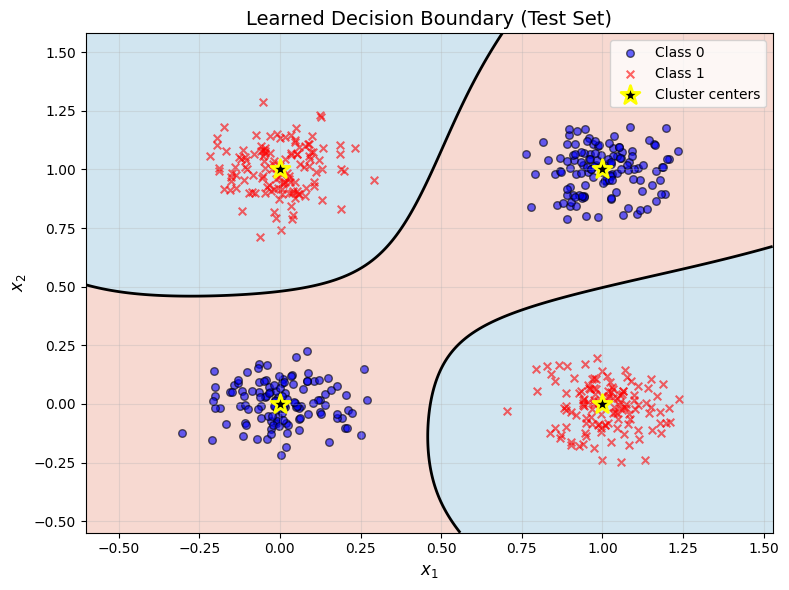

In [25]:
# Initialize model, criterion, and optimizer
# Using 1 hidden layer with 20 neurons as a baseline
model = DynamicXORModel(hidden_layers=1, hidden_dim=20)
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=0.01)

# Train the model
train_losses, val_losses = train_loop(model, train_loader, test_loader, criterion, optimizer, epochs=35)

# Visualization
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

# Plot decision boundary
plot_decision_boundary(model, X_test, y_test, title="Learned Decision Boundary (Test Set)")

## Experiment: Testing Network Architectures

We will now test a range of network architectures to see how depth and width affect performance on the noisy-XOR problem.
We will test combinations of:
- Depth (number of hidden layers): 0, 1, 2, 3
- Width (neurons per hidden layer): 1, 2, 3

For each combination, we will train the model multiple times and report the mean and standard deviation of the test loss.

In [26]:
# Experiment Configuration
depths = [0, 1, 2, 3, 5, 10, 20]
widths = [1, 2, 3, 5, 10, 20]
n_repetitions = 6  # Number of runs per configuration
epochs = 25

results_list = []

print(f"Starting experiment with depths={depths}, widths={widths}, repetitions={n_repetitions}")
print("-" * 60)
print(f"{'Depth':<10} {'Width':<10} {'Mean Loss':<15} {'Std Dev':<15}")
print("-" * 60)

for depth in depths:
    for width in widths:
        config_losses = []
        
        for i in range(n_repetitions):
            # Initialize model with specific architecture
            # Note: For depth=0, width parameter is ignored by our logic but we pass it anyway
            model = DynamicXORModel(input_dim=2, hidden_layers=depth, hidden_dim=width, output_dim=1)
            criterion = nn.BCELoss()
            optimizer = optim.Adam(model.parameters(), lr=0.01)
            
            # Train (suppress output with verbose=False)
            _, val_losses = train_loop(model, train_loader, test_loader, criterion, optimizer, epochs=epochs, verbose=False)
            
            # Record final validation loss
            final_loss = val_losses[-1]
            config_losses.append(final_loss)
            
        mean_loss = np.mean(config_losses)
        std_loss = np.std(config_losses)
        
        results_list.append({
            'Depth': depth, 
            'Width': width, 
            'Mean Loss': mean_loss, 
            'Std Dev': std_loss
        })
        
        print(f"{depth:<10} {width:<10} {mean_loss:<15.5f} {std_loss:<15.3f}")

# Store results in a DataFrame
results_df = pd.DataFrame(results_list)

Starting experiment with depths=[0, 1, 2, 3, 5, 10, 20], widths=[1, 2, 3, 5, 10, 20], repetitions=6
------------------------------------------------------------
Depth      Width      Mean Loss       Std Dev        
------------------------------------------------------------


0          1          0.69319         0.000          
0          2          0.69321         0.000          
0          2          0.69321         0.000          
0          3          0.69326         0.000          
0          3          0.69326         0.000          
0          5          0.69320         0.000          
0          5          0.69320         0.000          
0          10         0.69324         0.000          
0          10         0.69324         0.000          
0          20         0.69320         0.000          
0          20         0.69320         0.000          
1          1          0.48911         0.002          
1          1          0.48911         0.002          
1          2          0.13889         0.156          
1          2          0.13889         0.156          
1          3          0.01856         0.003          
1          3          0.01856         0.003          
1          5          0.00776         0.002          
1          5          0.0077

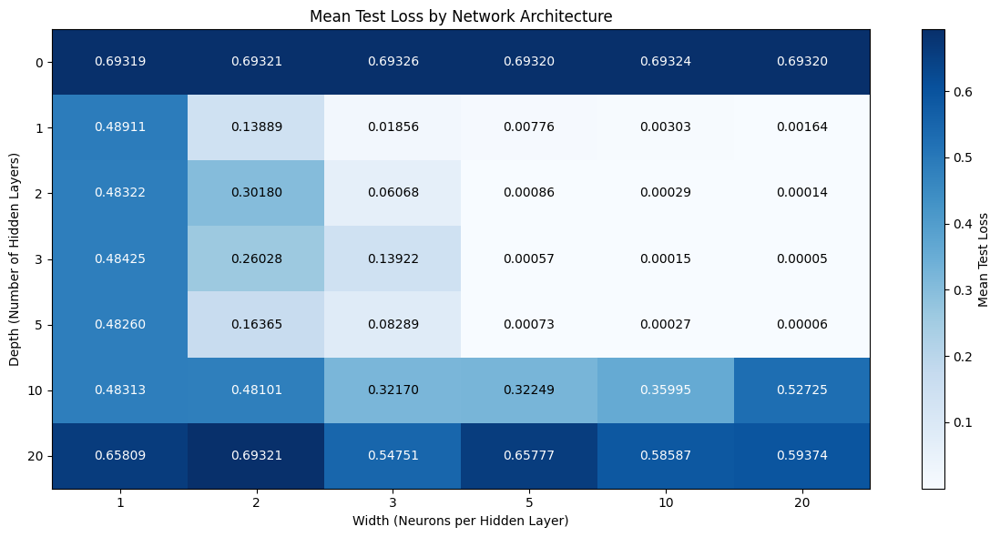

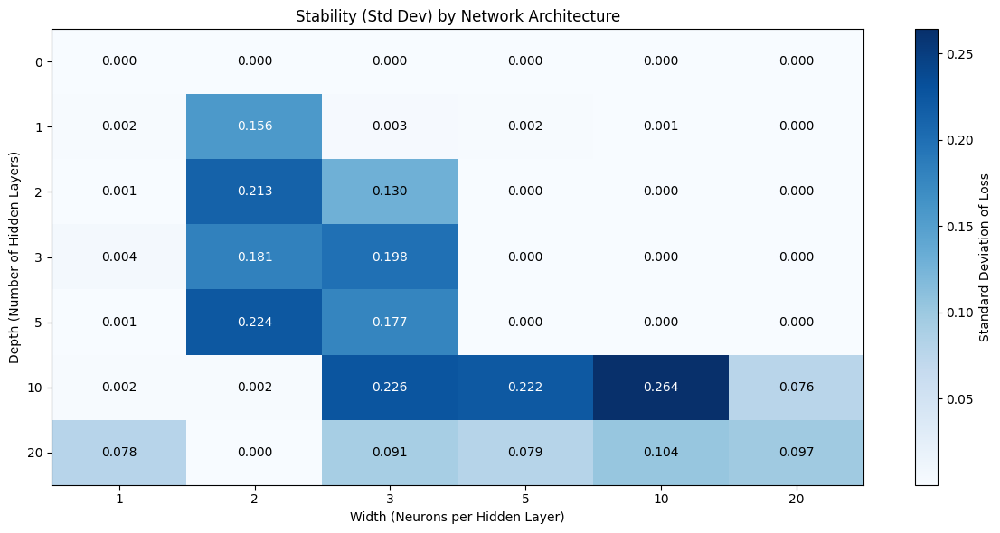

In [27]:
# Visualize the results
plt.figure(figsize=(12, 6))

# Pivot data for heatmap
# Use pivot_table instead of pivot to handle potential duplicate entries
pivot_table = results_df.pivot_table(index='Depth', columns='Width', values='Mean Loss')

# Plot heatmap
plt.imshow(pivot_table, cmap='Blues', aspect='auto')
plt.colorbar(label='Mean Test Loss')
plt.xlabel('Width (Neurons per Hidden Layer)')
plt.ylabel('Depth (Number of Hidden Layers)')
plt.title('Mean Test Loss by Network Architecture')

# Set ticks
plt.xticks(range(len(pivot_table.columns)), pivot_table.columns)
plt.yticks(range(len(pivot_table.index)), pivot_table.index)

# Add text annotations
for i in range(len(pivot_table.index)):
    for j in range(len(pivot_table.columns)):
        value = pivot_table.iloc[i, j]
        plt.text(j, i, f'{value:.5f}', ha='center', va='center', color='black' if value < 0.35 else 'white')

plt.tight_layout()
plt.show()

# Also plot standard deviation
plt.figure(figsize=(12, 6))
pivot_std = results_df.pivot_table(index='Depth', columns='Width', values='Std Dev')
plt.imshow(pivot_std, cmap='Blues', aspect='auto')
plt.colorbar(label='Standard Deviation of Loss')
plt.xlabel('Width (Neurons per Hidden Layer)')
plt.ylabel('Depth (Number of Hidden Layers)')
plt.title('Stability (Std Dev) by Network Architecture')
plt.xticks(range(len(pivot_std.columns)), pivot_std.columns)
plt.yticks(range(len(pivot_std.index)), pivot_std.index)

for i in range(len(pivot_std.index)):
    for j in range(len(pivot_std.columns)):
        value = pivot_std.iloc[i, j]
        plt.text(j, i, f'{value:.3f}', ha='center', va='center', color='black' if value < 0.15 else 'white')

plt.tight_layout()
plt.show()

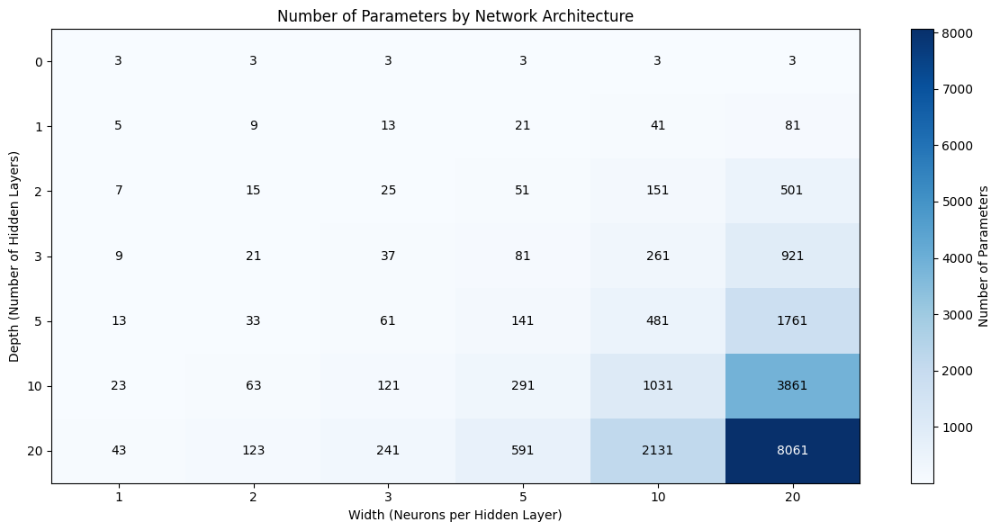

In [28]:
# Calculate number of parameters for each configuration
param_counts = []

for depth in depths:
    for width in widths:
        # Instantiate model to count parameters
        model = DynamicXORModel(input_dim=2, hidden_layers=depth, hidden_dim=width, output_dim=1)
        total_params = sum(p.numel() for p in model.parameters())
        
        param_counts.append({
            'Depth': depth,
            'Width': width,
            'Parameters': total_params
        })

params_df = pd.DataFrame(param_counts)

# Visualize Parameter Counts
plt.figure(figsize=(12, 6))
pivot_params = params_df.pivot_table(index='Depth', columns='Width', values='Parameters')
plt.imshow(pivot_params, cmap='Blues', aspect='auto')
plt.colorbar(label='Number of Parameters')
plt.xlabel('Width (Neurons per Hidden Layer)')
plt.ylabel('Depth (Number of Hidden Layers)')
plt.title('Number of Parameters by Network Architecture')
plt.xticks(range(len(pivot_params.columns)), pivot_params.columns)
plt.yticks(range(len(pivot_params.index)), pivot_params.index)

for i in range(len(pivot_params.index)):
    for j in range(len(pivot_params.columns)):
        value = pivot_params.iloc[i, j]
        plt.text(j, i, f'{int(value)}', ha='center', va='center', color='black' if value < pivot_params.max().max()/2 else 'white')

plt.tight_layout()
plt.show()

In [29]:
# 2 inputs -> 2 hidden units (Tanh) -> 1 output (Sigmoid)
model_viz = DynamicXORModel(input_dim=2, hidden_layers=1, hidden_dim=2, output_dim=1)
criterion = nn.BCELoss()
optimizer = optim.Adam(model_viz.parameters(), lr=0.05) # Higher LR to see faster convergence in animation

# Store weights history
history = []
epochs = 1000

print("Training minimal network for animation...")

for epoch in range(epochs):
    # Training step
    model_viz.train()
    optimizer.zero_grad()
    outputs = model_viz(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()
    
    # Save weights and bias every few epochs
    if epoch % 20 == 0 or epoch == epochs - 1:
        # Extract weights (assuming structure: Linear -> Tanh -> Linear -> Sigmoid)
        # Layer 1
        W1 = model_viz.network[0].weight.detach().numpy().copy()
        b1 = model_viz.network[0].bias.detach().numpy().copy()
        # Layer 2
        W2 = model_viz.network[2].weight.detach().numpy().copy()
        b2 = model_viz.network[2].bias.detach().numpy().copy()
        
        history.append({
            'epoch': epoch,
            'loss': loss.item(),
            'W1': W1, 'b1': b1,
            'W2': W2, 'b2': b2
        })

print(f"Training complete. Captured {len(history)} frames.")

# 2. Create Animation
def create_training_animation(history, X, y):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    plt.close() # Prevent double display
    
    # Create meshgrid for visualization
    xx, yy = np.meshgrid(np.linspace(-0.5, 1.5, 100),
                         np.linspace(-0.5, 1.5, 100))
    X_grid = np.c_[xx.ravel(), yy.ravel()]
    
    def update(frame_idx):
        data = history[frame_idx]
        W1, b1 = data['W1'], data['b1']
        W2, b2 = data['W2'], data['b2']
        
        # Manual forward pass using numpy
        # Layer 1: Linear + Tanh
        z1 = X_grid @ W1.T + b1
        h = np.tanh(z1)
        
        # Layer 2: Linear + Sigmoid
        z2 = h @ W2.T + b2
        out = 1 / (1 + np.exp(-z2))
        
        titles = ["Hidden Neuron 1", "Hidden Neuron 2", "Output"]
        activations = [h[:, 0], h[:, 1], out.flatten()]
        
        for i, ax in enumerate(axes):
            ax.clear()
            Z = activations[i].reshape(xx.shape)
            
            # Plot contour
            # For Tanh (Hidden), boundary is 0. For Sigmoid (Output), boundary is 0.5
            levels = [0] if i < 2 else [0.5]
            
            # Background color
            ax.contourf(xx, yy, Z, alpha=0.6, cmap='RdBu', vmin=-1 if i<2 else 0, vmax=1)
            
            # Decision boundary line
            try:
                ax.contour(xx, yy, Z, levels=levels, colors='black', linewidths=2)
            except:
                pass # No boundary in range
            
            # Plot data points
            mask_0 = y == 0
            mask_1 = y == 1
            ax.scatter(X[mask_0, 0], X[mask_0, 1], c='blue', marker='o', edgecolors='k', alpha=0.5)
            ax.scatter(X[mask_1, 0], X[mask_1, 1], c='red', marker='x', alpha=0.5)
            
            ax.set_title(titles[i])
            ax.set_xlim(-0.5, 1.5)
            ax.set_ylim(-0.5, 1.5)
            
        fig.suptitle(f"Epoch {data['epoch']} | Loss: {data['loss']:.4f}", fontsize=14)

    ani = animation.FuncAnimation(fig, update, frames=len(history), interval=100)
    return ani

# Generate and display animation
# Note: This might take a moment to render
ani = create_training_animation(history, X_train, y_train)
HTML(ani.to_jshtml())

Training minimal network for animation...
Training complete. Captured 51 frames.
Training complete. Captured 51 frames.


# Task 4 - MLOps

In [30]:
os.environ['WANDB_API_KEY'] = 'ee8848e4b81bff3ea50b004f3b28ce2deb74c1b1'
os.environ['WANDB_DIR'] = "/tmp"

In [31]:
# Training Loop with W&B Logging
def train_with_wandb(model, train_loader, val_loader, criterion, optimizer, epochs, config):
    # Initialize W&B
    wandb.init(
        project="noisy-xor-classification",
        config=config,
        name=f"depth{config['hidden_layers']}_width{config['hidden_dim']}"
    )
    
    # Watch the model
    wandb.watch(model, criterion, log="all", log_freq=10)
    
    for epoch in range(epochs):
        # Training phase
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0
        
        for inputs, targets in train_loader:
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            loss.backward()
            optimizer.step()
            
            running_loss += loss.item() * inputs.size(0)
            predicted = (outputs > 0.5).float()
            total += targets.size(0)
            correct += (predicted == targets).sum().item()
        
        epoch_train_loss = running_loss / len(train_loader.dataset)
        epoch_train_acc = 100 * correct / total
        
        # Validation phase
        model.eval()
        running_val_loss = 0.0
        correct = 0
        total = 0
        
        with torch.no_grad():
            for inputs, targets in val_loader:
                outputs = model(inputs)
                loss = criterion(outputs, targets)
                running_val_loss += loss.item() * inputs.size(0)
                
                predicted = (outputs > 0.5).float()
                total += targets.size(0)
                correct += (predicted == targets).sum().item()
        
        epoch_val_loss = running_val_loss / len(val_loader.dataset)
        epoch_val_acc = 100 * correct / total
        
        # Log metrics to W&B
        wandb.log({
            "epoch": epoch + 1,
            "train_loss": epoch_train_loss,
            "train_accuracy": epoch_train_acc,
            "val_loss": epoch_val_loss,
            "val_accuracy": epoch_val_acc,
            "learning_rate": optimizer.param_groups[0]['lr']
        })
    
    wandb.finish()

In [32]:
# Configuration
config = {
    "architecture": "DynamicXORModel",
    "input_dim": 2,
    "hidden_layers": 3,
    "hidden_dim": 10,
    "output_dim": 1,
    "optimizer": "Adam",
    "learning_rate": 0.01,
    "batch_size": 64,
    "epochs": 50,
    "loss_function": "BCELoss",
}

# Initialize model
model = DynamicXORModel(
    input_dim=config["input_dim"],
    hidden_layers=config["hidden_layers"],
    hidden_dim=config["hidden_dim"],
    output_dim=config["output_dim"]
)

criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=config["learning_rate"])

In [33]:
# Train the model with W&B logging
train_with_wandb(
    model=model,
    train_loader=train_loader,
    val_loader=test_loader,
    criterion=criterion,
    optimizer=optimizer,
    epochs=config["epochs"],
    config=config
)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize?ref=models
wandb: Paste an API key from your profile and hit enter:wandb: You can find your API key in your browser here: https://wandb.ai/authorize?ref=models
wandb: Paste an API key from your profile and hit enter:wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: No netrc file found, creating one.
wandb: Appending key for api.wandb.ai to your netrc file: /home/victorvj/.netrc
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: No netrc file found, creating o

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇██
learning_rate,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_accuracy,▁▇██████████████████████████████████████
train_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
learning_rate,0.01
train_accuracy,100
train_loss,6e-05
val_accuracy,100


In [34]:
# Hyperparameter sweep configuration
sweep_config = {
    'method': 'bayes',
    'metric': {
        'name': 'val_loss',
        'goal': 'minimize'
    },
    'parameters': {
        'hidden_layers': {
            'values': [1, 2, 3, 5]
        },
        'hidden_dim': {
            'values': [5, 10, 20, 30]
        },
        'learning_rate': {
            'distribution': 'log_uniform_values',
            'min': 0.001,
            'max': 0.1
        },
        'batch_size': {
            'values': [32, 64, 128]
        },
        'epochs': {
            'value': 50
        }
    }
}

sweep_id = wandb.sweep(sweep_config, project="noisy-xor-classification")

Create sweep with ID: nxml8uwu
Sweep URL: https://wandb.ai/victor-vangkilde-university-of-copenhagen/noisy-xor-classification/sweeps/nxml8uwu


In [35]:
# Training function for sweep
def train_sweep():
    wandb.init()
    
    # Get hyperparameters from wandb
    config = wandb.config
    
    # Recreate data loaders with sweep batch size
    train_loader_sweep = DataLoader(train_dataset, batch_size=config.batch_size, shuffle=True)
    test_loader_sweep = DataLoader(test_dataset, batch_size=config.batch_size, shuffle=False)
    
    # Create model with sweep parameters
    model = DynamicXORModel(
        input_dim=2,
        hidden_layers=config.hidden_layers,
        hidden_dim=config.hidden_dim,
        output_dim=1
    )
    
    criterion = nn.BCELoss()
    optimizer = optim.Adam(model.parameters(), lr=config.learning_rate)
    
    # Watch model
    wandb.watch(model, criterion, log="all", log_freq=10)
    
    # Training loop
    for epoch in range(config.epochs):
        # Training phase
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0
        
        for inputs, targets in train_loader_sweep:
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            loss.backward()
            optimizer.step()
            
            running_loss += loss.item() * inputs.size(0)
            predicted = (outputs > 0.5).float()
            total += targets.size(0)
            correct += (predicted == targets).sum().item()
        
        epoch_train_loss = running_loss / len(train_loader_sweep.dataset)
        epoch_train_acc = 100 * correct / total
        
        # Validation phase
        model.eval()
        running_val_loss = 0.0
        correct = 0
        total = 0
        
        with torch.no_grad():
            for inputs, targets in test_loader_sweep:
                outputs = model(inputs)
                loss = criterion(outputs, targets)
                running_val_loss += loss.item() * inputs.size(0)
                
                predicted = (outputs > 0.5).float()
                total += targets.size(0)
                correct += (predicted == targets).sum().item()
        
        epoch_val_loss = running_val_loss / len(test_loader_sweep.dataset)
        epoch_val_acc = 100 * correct / total
        
        # Log metrics
        wandb.log({
            "epoch": epoch + 1,
            "train_loss": epoch_train_loss,
            "train_accuracy": epoch_train_acc,
            "val_loss": epoch_val_loss,
            "val_accuracy": epoch_val_acc,
        })
    
    wandb.finish()

wandb.agent(sweep_id, train_sweep, count=30)

wandb: Agent Starting Run: 7zf5ti06 with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.029253675885776716
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.029253675885776716


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▄██████████████████████████████████████
train_loss,█▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▅▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00023
val_accuracy,100
val_loss,0.00019


wandb: Agent Starting Run: 13hidfko with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.04469972392378642
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.04469972392378642


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇██
train_accuracy,▁███████████████████████████████████████
train_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,█▁▅█▆███████████████████████████████████
val_loss,▂█▄▂▅▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.0
val_accuracy,100
val_loss,0.0


wandb: Agent Starting Run: lddh6x3r with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.055361533017637056
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.055361533017637056


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▄█▇▇█████████████████████████▇█████▇███
train_loss,█▆▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▂▁
val_accuracy,▁██▆▇█████████████████████████▁█████████
val_loss,█▂▃▄▃▁▁▂▁▁▁▁▂▁▁▁▁▁▂▁▂▂▁▁▁▁▁▂▂▂▄▂▁▂▁▁▁▂▁▁
epoch,50
train_accuracy,75
train_loss,0.48188
val_accuracy,75
val_loss,0.47944


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: y8s5q7g9 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.0050257903773157
wandb: Job received.
wandb: Agent Starting Run: y8s5q7g9 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.0050257903773157


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_loss,█▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,1e-05
val_accuracy,100
val_loss,1e-05


wandb: Agent Starting Run: jzw9l4u0 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.001164459954708152
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.001164459954708152


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇██
train_accuracy,▃▁▁▄▅███████████████████████████████████
train_loss,████▇▇▇▆▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▂▁▄▇▆███████████████████████████████████
val_loss,████▇▇▆▆▅▅▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00794
val_accuracy,100
val_loss,0.00738


wandb: Agent Starting Run: 1ltp0bv2 with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.04883225352683208
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.04883225352683208


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇██
train_accuracy,▁▂▅█████████████████████████████████████
train_loss,█▅▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▄██████████████████████████████████████
val_loss,█▇▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00088
val_accuracy,100
val_loss,0.00086


wandb: Agent Starting Run: bqruef4a with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.02385312765460366
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.02385312765460366


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,1e-05
val_accuracy,100
val_loss,0.0


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ytg2t7x7 with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: Job received.
wandb: Agent Starting Run: ytg2t7x7 with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.002640629176890382
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.002640629176890382


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇██
train_accuracy,▁▃▅█████████████████████████████████████
train_loss,██▇▅▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁██████████████████████████████████████
val_loss,██▆▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00034
val_accuracy,100
val_loss,0.00031


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: gybja77u with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.011250934547578617
wandb: Job received.
wandb: Agent Starting Run: gybja77u with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.011250934547578617


epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_loss,█▆▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.0
val_accuracy,100
val_loss,0.0


wandb: Agent Starting Run: ylqm7jzx with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.0011031602469074478
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.0011031602469074478


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▄▇█████████████████████████████████████
train_loss,██▆▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▇██████████████████████████████████████
val_loss,█▇▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.0003
val_accuracy,100
val_loss,0.00024


wandb: Agent Starting Run: v2wrhlmd with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.001644982594622594
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.001644982594622594


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇███
train_accuracy,▂▁▁▂▁▂▄▆▇███████████████████████████████
train_loss,████▇▇▆▆▅▅▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▁▄▁▄▅█████████████████████████████████
val_loss,█████▇▇▆▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00948
val_accuracy,100
val_loss,0.00879


wandb: Agent Starting Run: mh9pxe0s with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.008471679759776434
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.008471679759776434


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,4e-05
val_accuracy,100
val_loss,3e-05


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 9626i2ua with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.061410639748880474
wandb: Job received.
wandb: Agent Starting Run: 9626i2ua with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.061410639748880474


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,█▁▅█▅██▇████████████████████████████████
val_loss,▁█▄▁▆▁▁▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,1e-05
val_accuracy,100
val_loss,1e-05


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: q16ljdfb with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.04092824991609365
wandb: Job received.
wandb: Agent Starting Run: q16ljdfb with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.04092824991609365


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▅██████████████████████████████████████
train_loss,█▇▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_loss,█▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,9e-05
val_accuracy,100
val_loss,8e-05


wandb: Agent Starting Run: k0zx0at1 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.0013901261150321433
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.0013901261150321433


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▇██████████████████████████████████████
train_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,4e-05
val_accuracy,100
val_loss,3e-05


wandb: Agent Starting Run: q20c5utz with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.005309181646565973
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.005309181646565973


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▄██████████████████████████████████████
train_loss,█▆▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00011
val_accuracy,100
val_loss,0.0001


wandb: Agent Starting Run: ia85sbg9 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.0971683792290772
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.0971683792290772


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇█
train_accuracy,▁███████████████████████████████████████
train_loss,█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,1e-05
val_accuracy,100
val_loss,1e-05


wandb: Agent Starting Run: qubj0pmx with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.0028592476783062294
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.0028592476783062294


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▇██████████████████████████████████████
train_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,3e-05
val_accuracy,100
val_loss,3e-05


wandb: Agent Starting Run: cey0y5a9 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.003893788755027051
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.003893788755027051


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇██
train_accuracy,▁▃▄█████████████████████████████████████
train_loss,█▇▆▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▇█████████████████████████████████████
val_loss,█▇▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.0003
val_accuracy,100
val_loss,0.00028


wandb: Agent Starting Run: humju6wh with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.0037340654245210103
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.0037340654245210103


epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▇██████████████████████████████████████
train_loss,██▆▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▃██████████████████████████████████████
val_loss,█▇▅▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00019
val_accuracy,100
val_loss,0.00017


wandb: Agent Starting Run: dhf48dsc with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.005492285995134883
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.005492285995134883


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▅▁█▆███▆▆█▆█████████████████████████████
val_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,1e-05
val_accuracy,100
val_loss,1e-05


wandb: Agent Starting Run: lsmg1edv with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.004168934773190978
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.004168934773190978


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▁▃▆████████████████████████████████████
train_loss,███▇▇▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▂▆████████████████████████████████████
val_loss,██▇▆▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00118
val_accuracy,100
val_loss,0.00111


wandb: Agent Starting Run: x8ohwuzf with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.001636857120874883
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.001636857120874883


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▄▄▁▄▅▅▆█████████████████████████████████
train_loss,█████▆▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▄▁▂▄▄███████████████████████████████████
val_loss,████▇▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00476
val_accuracy,100
val_loss,0.00449


wandb: Agent Starting Run: 107cnuil with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.015657980185640692
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.015657980185640692


epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▄▇█████████████████████████████████████
train_loss,█▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁██████████████████████████████████████
val_loss,█▇▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,8e-05
val_accuracy,100
val_loss,8e-05


wandb: Agent Starting Run: ambsi1j9 with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.07319866510514227
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.07319866510514227


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇██
train_accuracy,▁▅██████████████████████████████████████
train_loss,█▅▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,4e-05
val_accuracy,100
val_loss,4e-05


wandb: Agent Starting Run: 5jti8kqo with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.01170979976973185
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.01170979976973185


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▆██████████████████████████████████████
train_loss,█▇▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▆▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00043
val_accuracy,100
val_loss,0.00037


wandb: Agent Starting Run: zgbt9w0i with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.017281187837913423
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.017281187837913423


epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,█▁█▅▆███████████████████████████████████
val_loss,▁█▁▆▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,1e-05
val_accuracy,100
val_loss,1e-05


wandb: Agent Starting Run: tx2k1fjx with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.005863509757819576
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.005863509757819576


epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
train_accuracy,▂▁▄▄▅███████████████████████████████████
train_loss,███▇▇▆▆▅▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▅▅▅▇███████████████████████████████████
val_loss,███▇▇▆▅▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00648
val_accuracy,100
val_loss,0.00598


wandb: Agent Starting Run: 1auq984b with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.005017198895614272
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.005017198895614272


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▂▁▅▅▅▅▅█████████████████████████████████
train_loss,████▇▇▆▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▄▄▄▅▅██████████████████████████████████
val_loss,████▇▆▅▄▄▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00451
val_accuracy,100
val_loss,0.00431


wandb: Agent Starting Run: pmz66j3g with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.00277170909960748
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.00277170909960748


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▃▁▁▂▄███████████████████████████████████
train_loss,████▇▆▆▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▃▁▁▁▁▄██████████████████████████████████
val_loss,████▇▇▆▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00247
val_accuracy,100
val_loss,0.00224
